In [1]:
using Pkg
Pkg.activate(".")
#Pkg.instantiate()
using PlotlyJS
using DelimitedFiles
using Statistics
using Flux
using Optim
using LinearAlgebra: norm, dot, cross
using Clustering: dbscan

function torusJet(R=2, r=1; ax=0.2, ay=-0.2)
    f(x, y, z) = (sqrt(x^2 + y^2) - R)^2 + (z - ax * x^2 - ay * y^2)^2 - r^2
    function ∇f(x, y, z)
        g = gradient(f, x, y, z)
        return [g[1], g[2], g[3]]
    end
    return f, ∇f
end

function ellipsoidJet(ax,ay,az)
    f(x, y, z) = x^2 / ax^2 + y^2 / ay^2 + z^2 / az^2 - 1
    function ∇f(x, y, z)
        g = gradient(f, x, y, z)
        return [g[1], g[2], g[3]]
    end
    return f, ∇f
end


function random_points(box, n)
    xs = rand(n) .* (box[2] - box[1]) .+ box[1]
    ys = rand(n) .* (box[4] - box[3]) .+ box[3]
    zs = rand(n) .* (box[6] - box[5]) .+ box[5]
    return xs, ys, zs
end


function cluster_points(xs, ys, zs)
    ps = [xs ys zs]'
    clusters = dbscan(ps, 0.05, min_neighbors=1, min_cluster_size=1)
    nxs = []
    nys = []
    nzs = []
    for cluster in clusters
        ids = cluster.core_indices
        append!(nxs, mean(xs[ids]))
        append!(nys, mean(ys[ids]))
        append!(nzs, mean(zs[ids]))
    end
    nxs, nys, nzs
end

function grid3d(box, n1, n2, n3)
    xs = range(box[1], box[2], length=n1)
    ys = range(box[3], box[4], length=n2)
    zs = range(box[5], box[6], length=n3)
    grid = zeros(n1 * n2 * n3, 3)
    for i = 1:n1
        for j = 1:n2
            for k = 1:n3
                grid[n1*n2*(i-1)+n2*(j-1)+k, :] = [xs[i], ys[j], zs[k]]
            end
        end
    end
    grid
end

function compute_normals(∇f, ps)
    gs = [∇f(ps[i, :]...) for i = 1:size(ps)[1]]
    gs = reduce(hcat, gs)'
    gs = gs ./ sqrt.(sum(gs .^ 2, dims=2))
    return gs
end

function get_triangle(n, ρ)
    f1 = n
    f2 = cross(n, [0, 1, 0])
    f2 = f2 / norm(f2)
    f3 = cross(f1, f2)
    f3 = f3 / norm(f3)
    ρ = 0.25
    n1 = f1 + ρ * (cos(0 * 2π / 3) * f2 + sin(0 * 2π / 3) * f3)
    n2 = f1 + ρ * (cos(1 * 2π / 3) * f2 + sin(1 * 2π / 3) * f3)
    n3 = f1 + ρ * (cos(2 * 2π / 3) * f2 + sin(2 * 2π / 3) * f3)
    # normalize n1,n2 and n3
    n1 = n1 / norm(n1)
    n2 = n2 / norm(n2)
    n3 = n3 / norm(n3)
    n1, n2, n3
end

function get_points_in_triangle(ps, ns, n1, n2, n3)
    n12 = cross(n1, n2)
    n23 = cross(n2, n3)
    n31 = cross(n3, n1)
    c12 = [dot(ns[i, :], n12) <= 0 for i = 1:size(ns)[1]]
    c23 = [dot(ns[i, :], n23) <= 0 for i = 1:size(ns)[1]]
    c31 = [dot(ns[i, :], n31) <= 0 for i = 1:size(ns)[1]]
    cond = c12 .&& c23 .&& c31
    return ps[cond, :]
end

function get_gauss_energy(a1, a2, d)
    function energy(p)
        e1 = f(p...)^2
        g = ∇f(p...)
        h = g / norm(g) - d / norm(d)
        e2 = dot(h, h)
        return a1 * e1 + a2 * e2
    end
end

function minimize_points(energy, ps)
    n = size(ps)[1]
    for i in 1:n
        p0 = [ps[i,1], ps[i,2], ps[i,3]]
        sol = optimize(energy,p0)
        p = sol.minimizer
        ps[i,1] = p[1]
        ps[i,2] = p[2]
        ps[i,3] = p[3]
    end
end

  Activating project at `~/Dropbox/My/Articles/ImplicitTriang/Julia/imptri`


minimize_points (generic function with 1 method)

# Plotting sphere triangulation

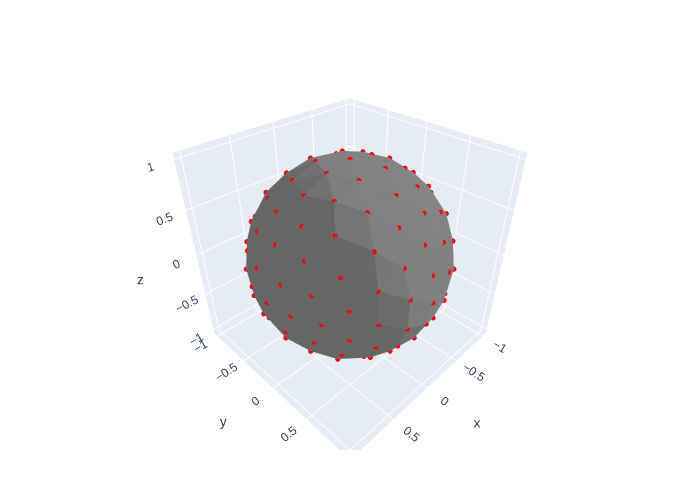

In [2]:

# read data from file
l = 2
vs = readdlm("../../SphereTriangulation/vertices$l.txt", Float64)
ts = readdlm("../../SphereTriangulation/triangles$l.txt", Int64)
ts = ts
nts = ts .+ 1


# Plot vs using PlotlyJS
sc = scatter3d(x=vs[:, 1], y=vs[:, 2], z=vs[:, 3], mode="markers", marker=attr(size=3, color="red"))

# create triangles graphics with veritices ns and triangles ts 

sphere_trace = GenericTrace[]
# mesh3d indexes vertices from 0, apparently!
mesh = mesh3d(x=vs[:, 1], y=vs[:, 2], z=vs[:, 3], i=ts[:, 1], j=ts[:, 2], k=ts[:, 3], color="gray", opacity=1.0, flatshading=true)

push!(sphere_trace, mesh)
push!(sphere_trace, sc)
layout = Layout(width=800, height=800, scene=attr(aspectmode="data"))
plot(sphere_trace, layout)

# Plotting surface scatter by thresholding

Points of surface count:45176

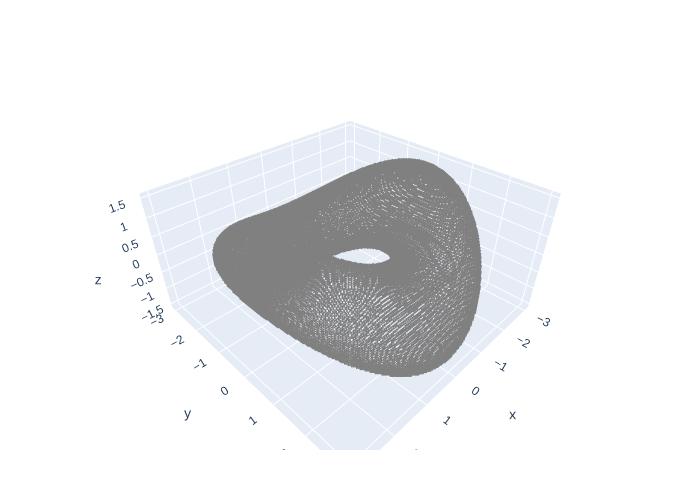

In [3]:
f, ∇f = torusJet(ax=0.1,ay=-0.1)
#f, ∇f = ellipsoidJet(.5,1,1.5)

g3d = grid3d([-3, 3, -3, 3, -2.5, 2.5], 128, 128, 128)
fs = [f(g3d[i, :]...) for i = 1:size(g3d)[1]]
ϵ = 0.05
ps = g3d[abs.(fs) .< ϵ, :]
print("Points of surface count:", size(ps)[1])

sc_ps = scatter3d(x=ps[:, 1], y=ps[:, 2], z=ps[:, 3], mode="markers", marker=attr(size=1, color="gray"))
plot([sc_ps], layout)

# What is this?

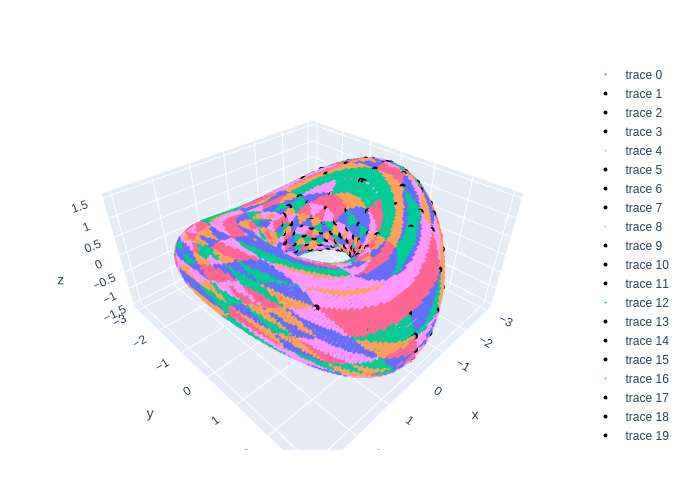

In [4]:
ns = compute_normals(∇f, ps)

# Create array for scatter3d objects
data = GenericTrace[]

#append!(data,[sc1])
#normals = [[1,0,0],[1,1,0],[1,1,1],[1,0,1]]
#for n in normals
#    println(n)
#    n1, n2, n3 = get_triangle(n, 0.5)
#    qs = get_points_in_triangle(ps, ns, n1,n2,n3)
#    sc = scatter3d(x=qs[:, 1], y=qs[:, 2], z=qs[:, 3], mode="markers", marker=attr(size=2))
#    append!(data, [sc])
#end


for i = 1:size(ts)[1]
    n1 = vs[nts[i, :], :][1, :]
    n2 = vs[nts[i, :], :][2, :]
    n3 = vs[nts[i, :], :][3, :]

    e1 = get_gauss_energy(1.0, 0.2, [n1[1],n1[2],n1[3]])
    e2 = get_gauss_energy(1.0, 0.2, [n2[1],n2[2],n2[3]])
    e3 = get_gauss_energy(1.0, 0.2, [n3[1],n3[2],n3[3]])


    qs = get_points_in_triangle(ps, ns, n1, n2, n3)

    qs1 =  copy(qs[1:2,:])
    qs2 =  copy(qs[2:3,:])
    qs3 =  copy(qs[[1,3],:])

    minimize_points(e1,qs1)
    minimize_points(e2,qs2)
    minimize_points(e3,qs3)

    scq = scatter3d(x=qs[:, 1], y=qs[:, 2], z=qs[:, 3], mode="markers", marker=attr(size=2))

    scq1 = scatter3d(x=qs1[:, 1], y=qs1[:, 2], z=qs1[:, 3], mode="markers", marker=attr(size=4, color="black"))
    scq2 = scatter3d(x=qs2[:, 1], y=qs2[:, 2], z=qs2[:, 3], mode="markers", marker=attr(size=4, color="black"))
    scq3 = scatter3d(x=qs3[:, 1], y=qs3[:, 2], z=qs3[:, 3], mode="markers", marker=attr(size=4, color="black"))

    append!(data, [scq])
    append!(data, [scq1])
    append!(data, [scq2])
    append!(data, [scq3])
end
plot(data, layout)

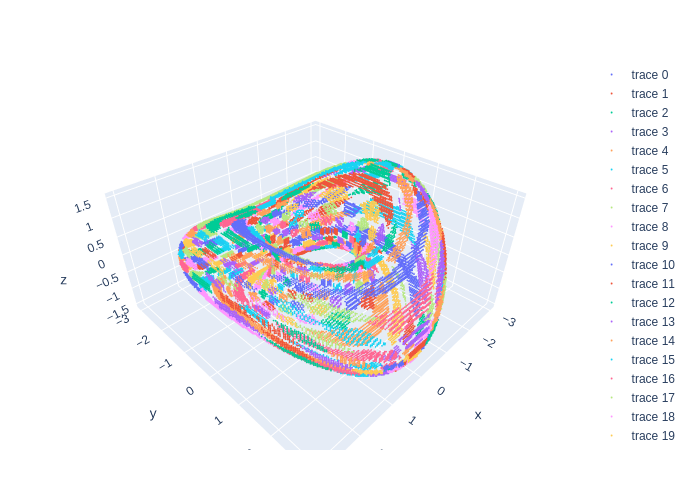

In [5]:
data = GenericTrace[]
ϵ = 0.1
for i = 1:size(vs)[1]
    n = vs[i,:]'
    #energy = get_gauss_energy(1.0, 0.2, [n[1],n[2],n[3]])
    diff = maximum(abs.(ns.-n),dims=2)[:,1]
    cond = (diff.<ϵ)
    if(sum(cond)==0)
        println("Emtry gauss inverse")
    end
    qs = ps[cond,:]
    #minimize_points(energy, qs)
    scq = scatter3d(x=qs[:, 1], y=qs[:, 2], z=qs[:, 3], mode="markers", marker=attr(size=1))
    append!(data, [scq])
end
plot(data, layout)